In [94]:
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [16, 9]

In [95]:
cap = cv2.VideoCapture('climbing.mp4')
c = 0
while True:
    ret, frame = cap.read()
    if not ret:
        print(c, c/9)
        break
    c += 1
cap.release()

292 32.44444444444444


**The video is 9 seconds long and I guess it is in 30 fps.**

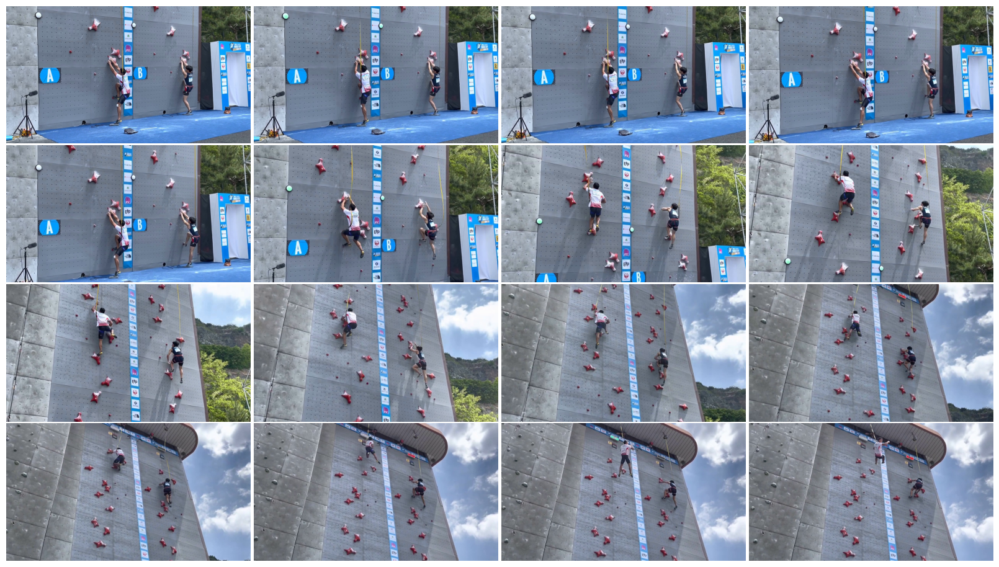

In [96]:
def display_frames(video_path='climbing.mp4', frame_dist=19, start_frame=0, transform=lambda x: x):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Create a 4x4 plot
    fig, axes = plt.subplots(4, 4)

    # Skip initial frames
    for _ in range(start_frame):
        ret, frame = cap.read()

    # Read and display 16 frames
    for i in range(16):
        # skip some frames
        for _ in range(frame_dist-1):
            ret, frame = cap.read()
        # run the detector and show images
        if ret:
            ax = axes[i//4, i%4]
            result_frame = transform(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            ax.imshow(result_frame)
            ax.axis('off')
        else:
            break
    
    cap.release()
    plt.tight_layout(pad=0.2)
    plt.show()

display_frames()

### Description
This is a video of speed climbing: athlete reaches the top of 15 meter tower in 5 seconds.
- on this video a person stays on ground for a couple of seconds at first, moving slightly
- then he jumps upwards and rushes to the top, moving in random directions intensively
- camera follows the person very smoothly and without zoom, while person gets further away
- at the end person gets off the wall again changing body position

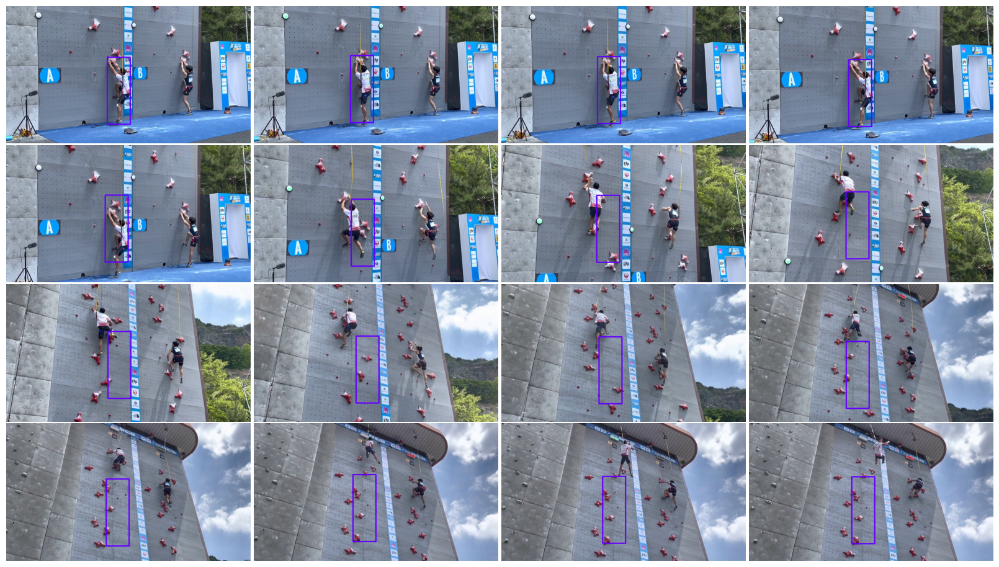

In [97]:
# create tracker object
tracker = cv2.TrackerMIL_create()

# get the first frame
cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

# initialize tracker
bbox = (530, 270, 120, 350)
ok = tracker.init(img, bbox)

# tracker callback
def tracker_mil(img):
    # run tracker
    ok, bbox = tracker.update(img)
    if ok:
        # draw bounding box
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(transform=tracker_mil)


**MIL: every 19th frame, big bbox**
- manages to track the object while it is on the ground
- can't keep up with the object after the jump
- does not report fail and keeps the bbox in a random position 

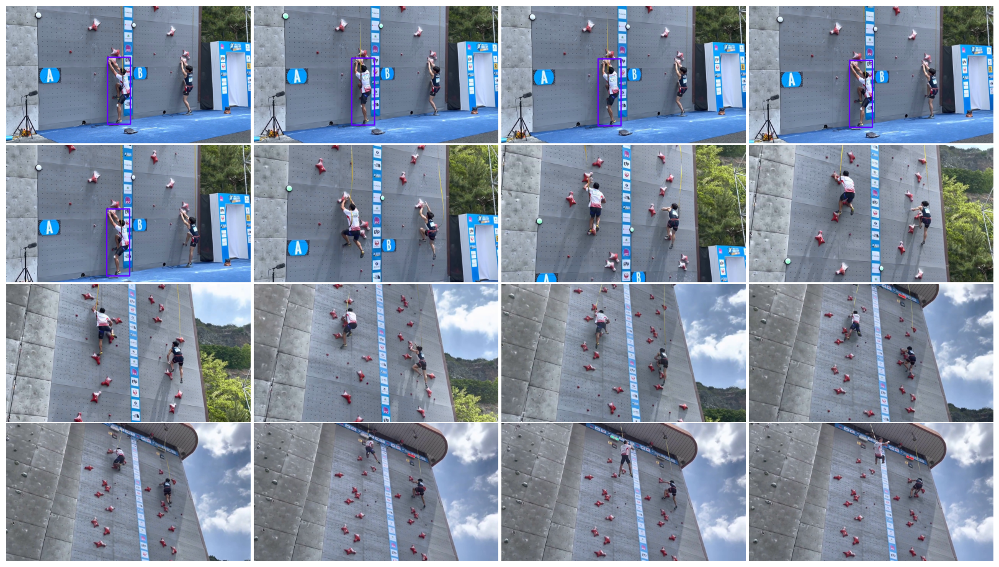

In [98]:
tracker = cv2.TrackerKCF_create()

cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

bbox = (530, 270, 120, 350)
ok = tracker.init(img, bbox)

def tracker_kcf(img):
    ok, bbox = tracker.update(img)
    if ok:
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(transform=tracker_kcf)


**KCF: every 19th frame, big bbox**
- gives more accurate track than MIL for grounded object
- looses track after jump and reports tracking fail (stops to return a bbox)

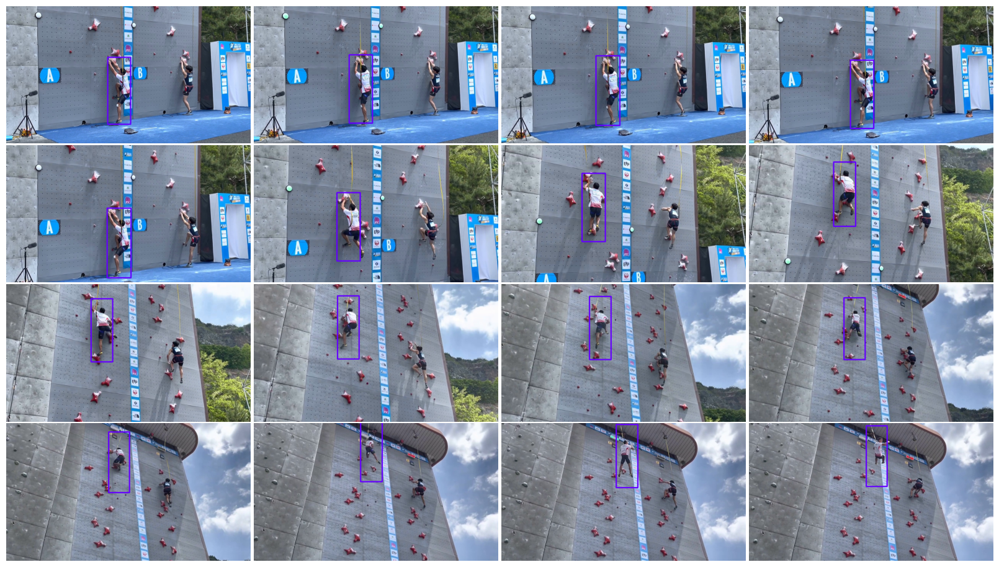

In [99]:
tracker = cv2.TrackerCSRT_create()

cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

bbox = (530, 270, 120, 350)
ok = tracker.init(img, bbox)

def tracker_csrt(img):
    ok, bbox = tracker.update(img)
    if ok:
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(transform=tracker_csrt)


**CSRT: every 19th frame, big bbox**
- even more accurate than KCF
- surprisingly, does not loose track neither after jump nor after the object gets further away, while intensivly changing the body position

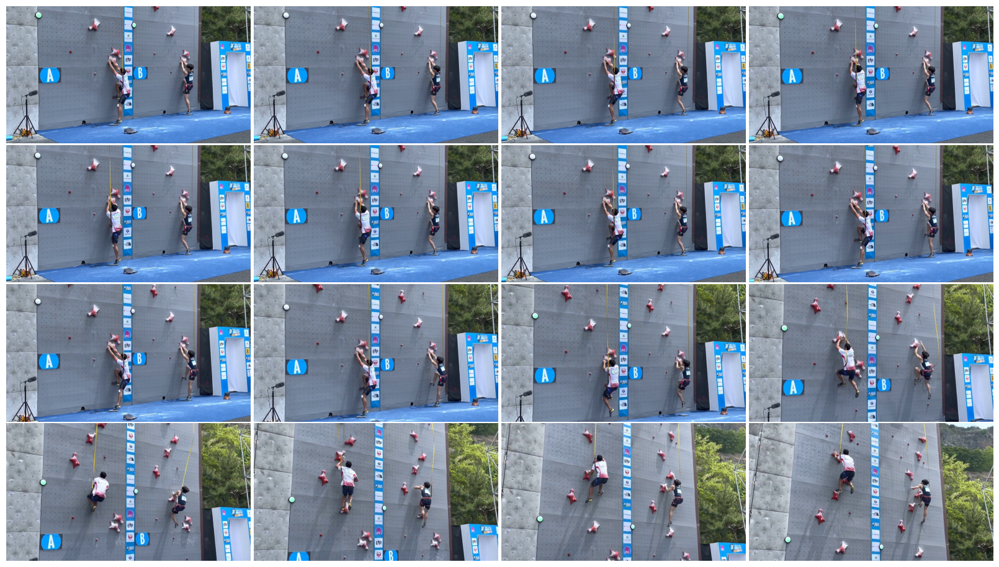

In [100]:
display_frames(frame_dist=10)

**every 9th frame, small bbox**
I have tried to make the initial bbox smaller, but neither of the algorithms couldn't track the climber after jump. I figured that the reason is smaller search window, so I decided to get denser frames ro make object speed lower.

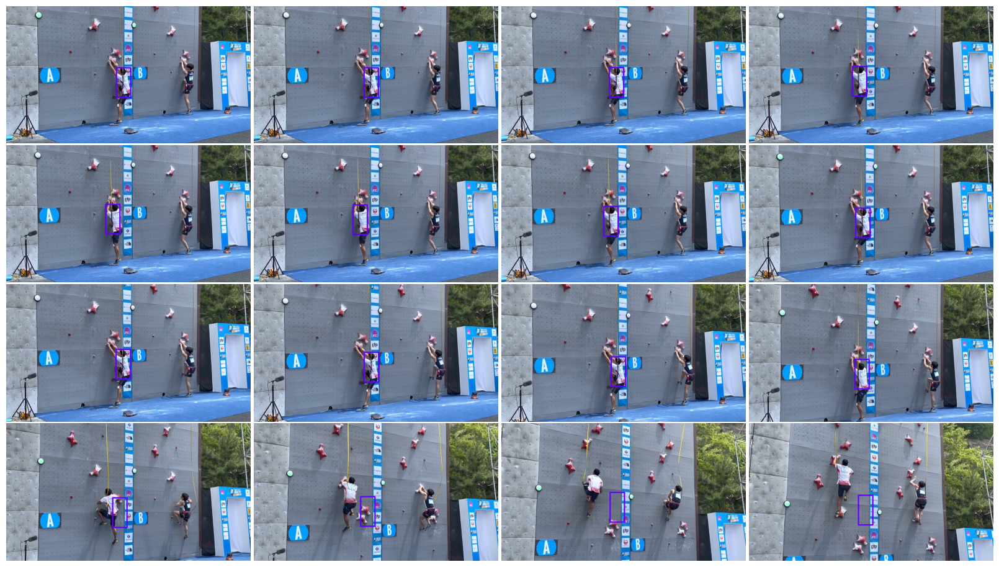

In [101]:
tracker = cv2.TrackerMIL_create()

cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

bbox = (575, 325, 75, 155)
ok = tracker.init(img, bbox)

def tracker_mil(img):
    ok, bbox = tracker.update(img)
    if ok:
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(frame_dist=9, transform=tracker_mil)


**MIL: every 9th frame, small bbox**
- with smaller box, tracker seems to work more accurately on the ground (because there is less background in the box)
- still looses track after jump

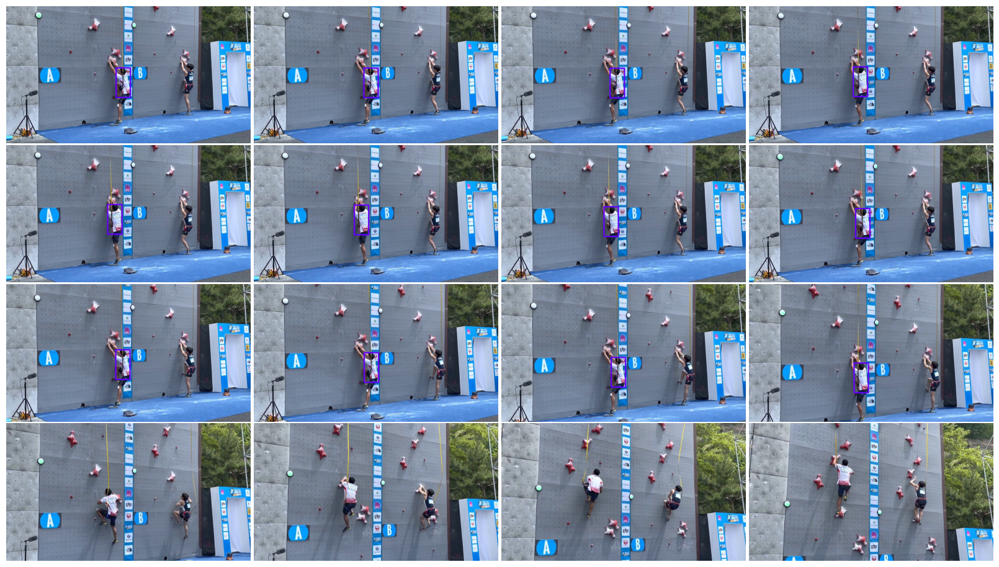

In [102]:
tracker = cv2.TrackerKCF_create()

cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

bbox = (575, 325, 75, 155)
ok = tracker.init(img, bbox)

def tracker_kcf(img):
    ok, bbox = tracker.update(img)
    if ok:
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(frame_dist=9, transform=tracker_kcf)


**KCF: every 9th frame, small bbox**
- same as before: a little bit more accurate that MIL and reports fail successfully

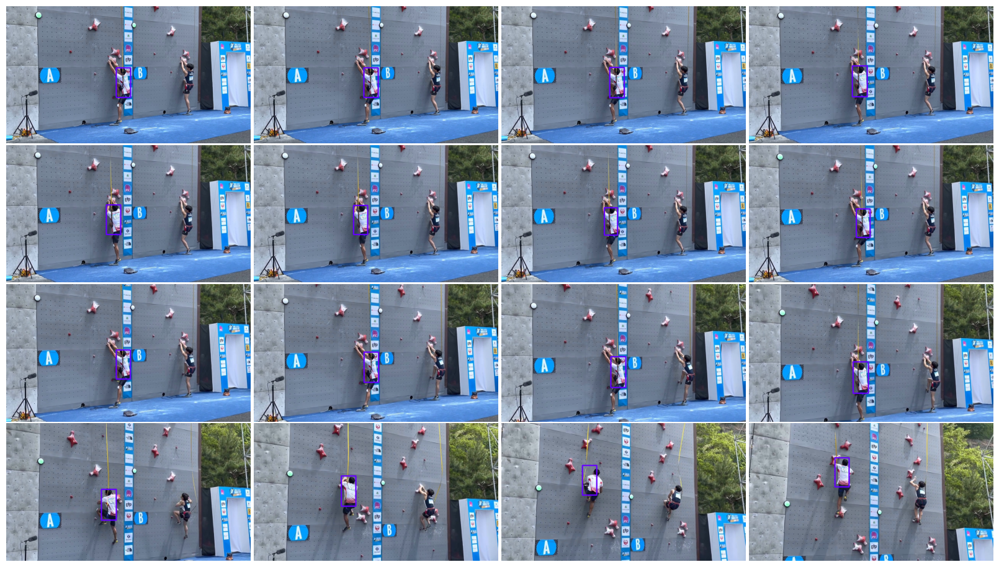

In [103]:
tracker = cv2.TrackerCSRT_create()


cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

bbox = (575, 325, 75, 155)
ok = tracker.init(img, bbox)

def tracker_csrt(img):
    ok, bbox = tracker.update(img)
    if ok:
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(frame_dist=9, transform=tracker_csrt)


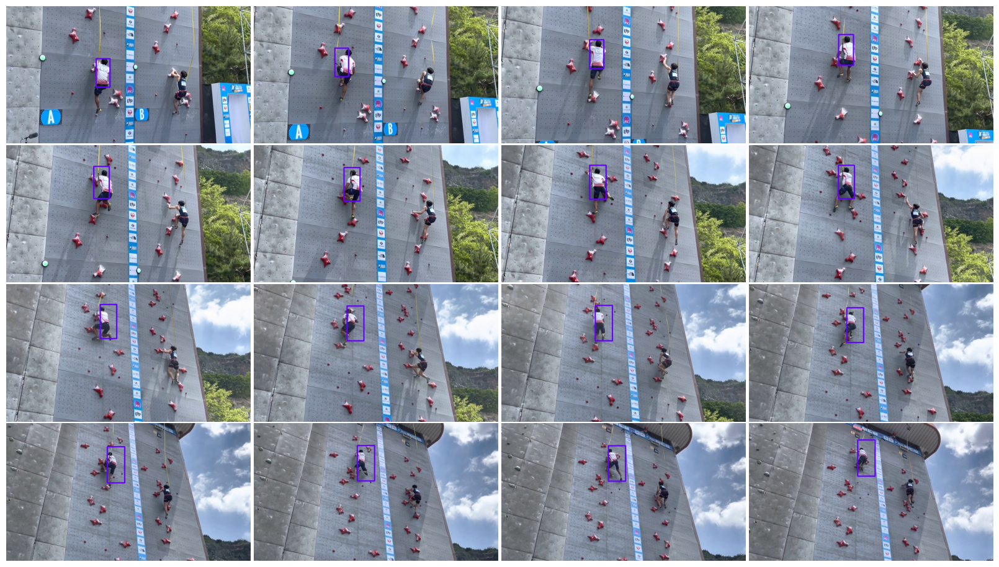

In [104]:
tracker = cv2.TrackerCSRT_create()


cap = cv2.VideoCapture('climbing.mp4')
ret, img = cap.read()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert ret
cap.release()

bbox = (575, 325, 75, 155)
ok = tracker.init(img, bbox)

def tracker_csrt(img):
    ok, bbox = tracker.update(img)
    if ok:
        p1 = (int(bbox[0]), int(bbox[1]))
        p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
        cv2.rectangle(img, p1, p2, (100, 0, 255), 5)
    return img

display_frames(frame_dist=9, start_frame=105, transform=tracker_csrt)


**CSRT: every 9th frame, small bbox**
- with denser frames sequence the detector works very good
- on last image trackers accuracy gets worse, but it doesn't loose the object
I think the error is caused by distance to the object: the original bbox template matches the later best in such position that bbox is translated to the right.

Bigger bbox played better on this matter: within it the object was surrounded by gray background, so when the distance increased, the bbox still kept the object approximately in the center so it could be evenly surrounded with background. Smaller bbox doesn't know about background, which could be a benefit, but in this case it allows the detector put the object to the side of the bbox. Maybe it is even aligning the bbox by persons head (or some other part), which doesn't change a lot between frames.